In [1]:
import pandas as pd
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
import statistics
import scipy
from scipy import signal

# Vaccine sentiment visualization

In [2]:
vaccine_tweets = pd.read_csv("../data/processed/vaccine_tweets_with_sentiment.csv", index_col=0, converters={'hashtags': eval, 'sentiment':eval})
vaccination_progress = pd.read_csv("../data/external/country_vaccinations.csv")
vaccination_progress_by_manufacturer = pd.read_csv("../data/external/country_vaccinations_by_manufacturer.csv")

In [129]:
vaccine_tweets.head()

,id,created_at,user,geo,full_text,hashtags,user_id,PfizerBiontech,SputnikV,Sinopharm,Sinovac,Moderna,AstraZeneca,Covaxin,JandJ,user_location,coordinates,corpus,sentiment,sentiment_compound
0,1382113874439192576,2021-04-13 23:30:00+00:00,"{'id': 758414676480946200, 'id_str': '75841467...",NaN,"""Safe and Effective, Safe and Effective, Safe ...","[mrna, covidvaccine, johnsonandjohnson, pfizer...",758414676480946200,1,0,0,1,1,1,0,1,NaN,NaN,safe effective safe effective safe effective s...,"{'neg': 0.0, 'neu': 0.104, 'pos': 0.896, 'comp...",0.9953
1,1362299993504145408,2021-02-18 07:16:43+00:00,"{'id': 160763636, 'id_str': '160763636', 'name...",NaN,Hey dear friends my #COVAXIN is done and feel ...,"[covaxin, covid19, vaccinemaitri]",160763636,0,0,0,0,0,0,1,0,India,"[22.3511148, 78.6677428]",hey dear friend covaxin done feel good thanks ...,"{'neg': 0.0, 'neu': 0.311, 'pos': 0.689, 'comp...",0.9876
2,1375483502616010752,2021-03-26 16:23:16+00:00,"{'id': 1356008062620991500, 'id_str': '1356008...",NaN,We will be giving thousands of doses of the in...,"[oxfordastrazeneca, passover, covidjab]",1356008062620991500,0,0,0,0,0,1,0,0,NaN,NaN,giving thousand dos incredibly safe powerfully...,"{'neg': 0.0, 'neu': 0.298, 'pos': 0.702, 'comp...",0.9842
3,1367114490890752000,2021-03-03 14:07:49+00:00,"{'id': 143025857, 'id_str': '143025857', 'name...",NaN,Better efficacy than Oxford/covishield's 62%. ...,[covaxin],143025857,0,0,0,0,0,0,1,0,NaN,NaN,better efficacy oxford covishield best inactiv...,"{'neg': 0.0, 'neu': 0.339, 'pos': 0.661, 'comp...",0.9837
4,1395429383582724096,2021-05-20 17:21:05+00:00,"{'id': 19386982, 'id_str': '19386982', 'name':...",NaN,Huge thank you to the wonderful @HSELive staff...,[moderna],19386982,0,0,0,0,1,0,0,0,NaN,NaN,huge thank wonderful staff race got cancellati...,"{'neg': 0.0, 'neu': 0.311, 'pos': 0.689, 'comp...",0.9813


In [4]:
vaccination_progress_by_manufacturer = vaccination_progress_by_manufacturer.groupby(["vaccine","date"])["total_vaccinations"].sum().reset_index()

---

# Amount of vaccine mentions

In [5]:
fig = px.pie(vaccine_tweets,
             values=[
                 vaccine_tweets.PfizerBiontech.sum(),
                 vaccine_tweets.SputnikV.sum(),
                 vaccine_tweets.Sinopharm.sum(),
                 vaccine_tweets.Sinovac.sum(),
                 vaccine_tweets.Moderna.sum(),
                 vaccine_tweets.AstraZeneca.sum(),
                 vaccine_tweets.Covaxin.sum(),
                 vaccine_tweets.JandJ.sum()
                    ],
             names=[
                 "PfizerBiontech",
                 "SputnikV",
                 "Sinopharm",
                 "Sinovac",
                 "Moderna",
                 "AstraZeneca",
                 "Covaxin",
                 "JandJ"
                   ],
             title='Total Vaccine Mentions')
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.write_html("../reports/figures/VaccineSentiment/Vaccine_Mentions.html")

fig.show()

**The most talked about vaccine is BharatBiontechs Covaxin, followed by Moderna and PfizerBiontech.**

___

# Vaccines by daily tweet volume

extract date from timestamp and count the occurrence per day:

In [6]:
vaccine_tweets_temp = vaccine_tweets.copy()
vaccine_tweets_temp["created_at"] = pd.to_datetime(vaccine_tweets["created_at"]).dt.strftime('%Y-%m-%d')
vaccine_tweets_temp["count"] = 1

In [7]:
 vaccine_tweets_temp = vaccine_tweets_temp[["created_at", "PfizerBiontech", "SputnikV", "Sinopharm", "Sinovac", "Moderna", "AstraZeneca", "Covaxin", "JandJ","count"]]

In [8]:
vaccine_tweets_temp_count = vaccine_tweets_temp.groupby(["created_at"])["PfizerBiontech", "SputnikV", "Sinopharm", "Sinovac", "Moderna", "AstraZeneca", "Covaxin", "JandJ"].sum()

<ipython-input-8-7a292a2c6dc0>:1: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



In [9]:
vaccine_tweets_temp_count = vaccine_tweets_temp_count.reset_index(drop = False)

Change the list, so that all vaccines are in a column:

In [134]:
vax_tweets = pd.DataFrame(columns=["created_at","Vaccine","TweetAmount"])

for i in range(len(vaccine_tweets_temp_count)):
    for column in (vaccine_tweets_temp_count.columns[1:]):
        vax_tweets.loc[len(vax_tweets)+1] = [vaccine_tweets_temp_count["created_at"][i], column, vaccine_tweets_temp_count[column][i]]

In [136]:
fig = px.bar(vax_tweets, x="Vaccine", y="TweetAmount",\
             animation_frame=vax_tweets.created_at, range_y=[0,800],\
             title="Tweet Volume by day")
fig.layout.updatemenus[0].buttons[0].args[1]["frame"]["duration"] = 20 #animation speed
fig.show()
fig.write_html("../reports/figures/VaccineSentiment/Tweet_Volume_Day.html")

**Tweet volume of each vaccine by day. Achieved by counting the amount of tweets containing a hashtag of a vaccine on said day.**

___

## Vaccines by absolute tweet volume

For the absolute volume, the vaccine tweet volume of each day is added to the subsequent day:

In [148]:
vax_tweets_2 = vaccine_tweets_temp_count.copy()

for column in vax_tweets_2.columns[1:]:
    for i in range(len(vax_tweets_2[column])-1):
        vax_tweets_2[column][i+1] = vax_tweets_2[column][i]+vax_tweets_2[column][i+1]

<ipython-input-148-67e0ac08173c>:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Change list so vaccines are in a column:

In [13]:
vax_tweets_3 = pd.DataFrame(columns=["created_at","Vaccine","TweetAmount"])

for i in range(len(vax_tweets_2)):
    for column in (vax_tweets_2.columns):
        if column != "created_at":
            vax_tweets_3.loc[len(vax_tweets_3)+1] = [vax_tweets_2["created_at"][i], column, vax_tweets_2[column][i]]

In [149]:
fig = px.bar(vax_tweets_3, x="Vaccine", y="TweetAmount",\
             title="Tweet Volume Over Time",\
             animation_frame=vax_tweets.created_at, range_y=[0,45000])
fig.layout.updatemenus[0].buttons[0].args[1]["frame"]["duration"] = 20
fig.show()
fig.write_html("../reports/figures/VaccineSentiment/Tweet_Volume_All.html")

___

# Positive, negative and neutral sentiment

Split the sentiment three ways to generate discrete variables:
- any sentiment less than -0.33 is negative, above 0.33 is positive and anything in between is neutral

In [15]:
pos_sentiment = [sentiment for sentiment in vaccine_tweets["sentiment_compound"] if (sentiment >= 0.33)]
neg_sentiment = [sentiment for sentiment in vaccine_tweets["sentiment_compound"] if (sentiment <= - 0.33)]
neu_sentiment = [sentiment for sentiment in vaccine_tweets["sentiment_compound"] if (sentiment < 0.33 and sentiment > -0.33)]

In [16]:
fig = px.box(
    y=vaccine_tweets["sentiment_compound"],
    title = "Overall Sentiment",
    labels={"y":"Sentiment"})
fig.show()
fig.write_html("../reports/figures/VaccineSentiment/Sentiment_Boxplot.html")

**Sentiment is overall neutral with a positive tendency. There are however outliers reaching far negative sentiment**

In [17]:
fig = px.bar(
    x=["Positive", "Neutral", "Negative"],
    y=[len(pos_sentiment), len(neu_sentiment), len(neg_sentiment)],
    title="Amount of tweets by sentiment",
    labels={"x":"Sentiment","y":"Amount of tweets"})
fig.show()
fig.write_html("../reports/figures/VaccineSentiment/Sentiment_Amount.html")

**Most tweets are neutral. Positive tweets are almost double the negative tweets.**

Positive Tweet (Sentiment = 0.98):

In [166]:
vaccine_tweets[vaccine_tweets["id"]==1362299993504145408]["full_text"].iloc[0]

'Hey dear friends my #COVAXIN is done and feel good. Thanks so much india ð\x9f\x87®ð\x9f\x87³ and Indian scientists for your wonderful achievements. Feel proud as a Indian. Yes my government doing great work for our people. Thanks ð\x9f\x99\x8fð\x9f\x8f» ð\x9f\x87®ð\x9f\x87³ love â\x9d¤ï¸\x8f and respect #COVID19 #VaccineMaitri'

Neutral Tweet (Sentiment = 0):

In [165]:
vaccine_tweets[vaccine_tweets["id"]==1398159083543306240]["full_text"].iloc[0]

"If you've taken #Covaxin (Manipal Hospital, #Goa),  you can book your second slot based on the dates given in your provisional certificate. Slots till 5th June are currently open. https://t.co/OiSbzoZKkU"

Negative Tweet (Sentiment = -0.68):

In [171]:
vaccine_tweets[vaccine_tweets["id"]==1382615821210427392]["full_text"].iloc[0]

"The Gates of Hell &amp; 'Luciferase' https://t.co/qmZzbqMHra via @C_H_Industries #Pfizer #Yeadon #luciferase #vaccine #Moderna #BillGates #Gates"

___

# Average Sentiment by Vaccine

Split dataframe in order to get sentiment sentiment of each vaccine

In [18]:
pfizerBiontech_tweets = vaccine_tweets[vaccine_tweets["PfizerBiontech"] == 1][["created_at","sentiment_compound"]].set_index("created_at")
sputnikV_tweets = vaccine_tweets[vaccine_tweets["SputnikV"] == 1][["created_at","sentiment_compound"]].set_index("created_at")
sinopharm_tweets = vaccine_tweets[vaccine_tweets["Sinopharm"] == 1][["created_at","sentiment_compound"]].set_index("created_at")
sinovac_tweets = vaccine_tweets[vaccine_tweets["Sinovac"] == 1][["created_at","sentiment_compound"]].set_index("created_at")
moderna_tweets = vaccine_tweets[vaccine_tweets["Moderna"] == 1][["created_at","sentiment_compound"]].set_index("created_at")
astraZeneca_tweets = vaccine_tweets[vaccine_tweets["AstraZeneca"] == 1][["created_at","sentiment_compound"]].set_index("created_at")
covaxin_tweets = vaccine_tweets[vaccine_tweets["Covaxin"] == 1][["created_at","sentiment_compound"]].set_index("created_at")
jandj_tweets = vaccine_tweets[vaccine_tweets["JandJ"] == 1][["created_at","sentiment_compound"]].set_index("created_at")

In [174]:
pfizerBiontech_avg_sentiment = pfizerBiontech_tweets["sentiment_compound"].mean()
sputnikV_avg_sentiment = sputnikV_tweets["sentiment_compound"].mean()
sinopharm_avg_sentiment = sinopharm_tweets["sentiment_compound"].mean()
sinovac_avg_sentiment = sinovac_tweets["sentiment_compound"].mean()
moderna_avg_sentiment = moderna_tweets["sentiment_compound"].mean()
astraZeneca_avg_sentiment = astraZeneca_tweets["sentiment_compound"].mean()
covaxin_avg_sentiment = covaxin_tweets["sentiment_compound"].mean()
jandj_avg_sentiment = jandj_tweets["sentiment_compound"].mean()

In [20]:
fig = px.bar(
    x=["PfizerBiontech", "SputnikV", "Sinopharm", "Sinovac", "Moderna", "AstraZeneca", "Covaxin", "JandJ"],
    y=[pfizerBiontech_avg_sentiment, sputnikV_avg_sentiment, sinopharm_avg_sentiment, sinovac_avg_sentiment, moderna_avg_sentiment, astraZeneca_avg_sentiment, covaxin_avg_sentiment, jandj_avg_sentiment],
    title="Mean sentiment by Vaccine",
    labels={"x":"Vaccine","y":"Mean sentiment"})
fig.show()
fig.write_html("../reports/figures/VaccineSentiment/Mean_Vaccine_Sentiment.html")

**The sentiment of e.g. JandJ and SputnikV are questionable because the overall tweet volume of these two weren't high, so a few people can influence the sentiment big time**

In [21]:
fig = px.box(
    y=pfizerBiontech_tweets["sentiment_compound"],
    points="suspectedoutliers",
    title = "Overall Sentiment for PfizerBiontech",
    labels={"y":"Sentiment"})
fig.show()
fig.write_html("../reports/figures/VaccineSentiment/Overall_Sentiment_PfizerBiontech.html")

___

# Vaccine sentiment over time

Merge the vaccine dataframes together (outer join by "created_at"):

In [23]:
merged_vaccine_tweets = pd.merge(pfizerBiontech_tweets, sputnikV_tweets, left_index=True, right_index=True, how='outer')\
.merge(sinopharm_tweets, left_index=True, right_index=True, how="outer")\
.merge(sinovac_tweets, left_index=True, right_index=True, how="outer")\
.merge(moderna_tweets, left_index=True, right_index=True, how="outer")\
.merge(astraZeneca_tweets, left_index=True, right_index=True, how="outer")\
.merge(covaxin_tweets, left_index=True, right_index=True, how="outer")\
.merge(jandj_tweets, left_index=True, right_index=True, how="outer")

In [24]:
merged_vaccine_tweets.columns = ["PfizerBiontech","SputnikV","Sinopharm","Sinovac","Moderna","AstraZeneca","Covaxin","JandJ"]

Compare vaccine progress data to vaccine sentiment:

In [181]:
vaccination_progress_by_manufacturer[vaccination_progress_by_manufacturer["vaccine"] == "Johnson&Johnson"]

,vaccine,date,total_vaccinations
30,Johnson&Johnson,2020-12-27,0
31,Johnson&Johnson,2020-12-28,0
32,Johnson&Johnson,2020-12-29,0
33,Johnson&Johnson,2020-12-30,0
34,Johnson&Johnson,2020-12-31,0
...,...,...,...
212,Johnson&Johnson,2021-06-27,16448315
213,Johnson&Johnson,2021-06-28,16522666
214,Johnson&Johnson,2021-06-29,18555049
215,Johnson&Johnson,2021-06-30,16723354


In [27]:
total_vaccine_process = vaccination_progress.groupby(["date"])["total_vaccinations"].sum().reset_index()

In [185]:
total_vaccine_process

,date,total_vaccinations
0,2020-12-02,0.000000e+00
1,2020-12-03,0.000000e+00
2,2020-12-04,1.000000e+00
3,2020-12-05,0.000000e+00
4,2020-12-06,0.000000e+00
...,...,...
207,2021-06-27,2.910081e+09
208,2021-06-28,2.968104e+09
209,2021-06-29,2.990110e+09
210,2021-06-30,2.899115e+09


In [187]:
vaccination_progress_by_manufacturer["vaccine"].unique()[1:]

array(['Johnson&Johnson', 'Moderna', 'Oxford/AstraZeneca',
       'Pfizer/BioNTech', 'Sinopharm/Beijing', 'Sinovac', 'Sputnik V'],
      dtype=object)

Create a plot with a dropdown that includes all vaccines:
- the way this works is that you create many traces (think canvas)
- with a list containing boolean values, you can turn each trace on or off (becomes variable, depending on the selected button)
- the first set of traces (first for loop) plots the bar chart for the vaccine progress
- the second set of traces plots the sentiment over time
    - sentiment was smoothed through savitzky-golay filter

In [127]:
def sentiment_over_time(dataset):

    fig = go.Figure()
    
    for vaccine in vaccination_progress_by_manufacturer["vaccine"].unique()[1:]:
        fig.add_trace(
            go.Bar(
            x = vaccination_progress_by_manufacturer[vaccination_progress_by_manufacturer["vaccine"]==vaccine]["date"],
            y = vaccination_progress_by_manufacturer[vaccination_progress_by_manufacturer["vaccine"]==vaccine]["total_vaccinations"],
            yaxis='y1',
            name= vaccine + " doses",
            marker_color='orange'
            )
        )

    
    for column in dataset.columns.to_list():
        fig.add_trace(
            go.Line(
                x = dataset.sort_values("created_at")[column].dropna().index,
                y = signal.savgol_filter(
                    dataset.sort_values("created_at")[column].dropna(),
                    201,
                    4
                    ),
                yaxis = "y2",
                name = column + " senti."
            )
        )
        
    
    # Add dropdown
    fig.update_layout(
        updatemenus=[
            dict(
                buttons=list([
                    dict( 
                        args=[{'visible': [True,True,True,True,True,True,True,True,True,True,True,True,True,True,True]}, 
                               {'title' : '(Smoothed) Sentiment over time'}],
                        label="All",
                        method="update"
                    ),
                    dict( 
                        args=[{'visible': [False,False,False,True,False,False,False,True,False,False,False,False,False,False,False]},
                             {'title' : '(Smoothed) Sentiment over time for PfizerBiontech'}],
                        label="PfizerBiontech",
                        method="update"
                    ),
                    dict(
                        args=[{'visible': [False,False,False,False,False,False,True,False,True,False,False,False,False,False,False]},
                             {'title' : '(Smoothed) Sentiment over time for SputnikV'}],
                        label="SputnikV",
                        method="update"
                    ),
                    dict(
                        args=[{'visible': [False,False,False,False,True,False,False,False,False,True,False,False,False,False,False]},
                             {'title' : '(Smoothed) Sentiment over time for Sinopharm'}],
                        label="Sinopharm",
                        method="update",
                    ),
                    dict(
                        args=[{'visible': [False,False,False,False,False,True,False,False,False,False,True,False,False,False,False]},
                             {'title' : '(Smoothed) Sentiment over time for Sinovac'}],
                        label="Sinovac",
                        method="update"
                    ),
                    dict(
                        args=[{'visible': [False,True,False,False,False,False,False,False,False,False,False,True,False,False,False]}, 
                             {'title' : '(Smoothed) Sentiment over time for Moderna'}],
                        label="Moderna",
                        method="update"
                    ),
                    dict(
                        args=[{'visible': [False,False,True,False,False,False,False,False,False,False,False,False,True,False,False]}, 
                             {'title' : '(Smoothed) Sentiment over time for AstraZeneca'}],
                        label="AstraZeneca",
                        method="update"
                    ),
                    dict(
                        args=[{'visible': [False,False,False,False,False,False,False,False,False,False,False,False,False,True,False]},
                             {'title' : '(Smoothed) Sentiment over time for Covaxin'}],
                        label="Covaxin",
                        method="update"
                    ),
                    dict(
                        args=[{'visible': [True,False,False,False,False,False,False,False,False,False,False,False,False,False,True]},
                             {'title' : '(Smoothed) Sentiment over time for JandJ'}],
                        label="JandJ",
                        method="update"
                    )                    
                ]),
                direction="down",
                pad={"r": 10, "t": 10},
                showactive=True,
                x=1.0,
                xanchor="right",
                y=1.2,
                yanchor="top"
            ),
        ],
        xaxis_title="Time",
        legend_title="Vaccines"
    )
    
    fig.update(layout=go.Layout(yaxis1 = go.YAxis(title='Vaccination Progress', titlefont=go.Font(color='Orange'), side="right"),
                                yaxis2 = go.YAxis(title='Sentiment', titlefont=go.Font(color='Red'), overlaying='y', side="left")))
    
    fig.show()
    fig.write_html("../reports/figures/VaccineSentiment/Vaccine_Sentiment_Over_Time.html")

In [128]:
sentiment_over_time(merged_vaccine_tweets)

- **Vaccines used in predominantly in the U.S. have a dip on valentines and memorial day.**
- **A possible reason for the sentiment might be world news**
    - **for that we use google trends to determine what the most searched terms were at a given date**

___

## Google Trends analysis (w/ pytrends):

In [31]:
from pytrends.request import TrendReq

In [33]:
def getRisingTrends(query, time, qtype="rising"):
    pytrend = TrendReq()
    pytrend.build_payload(kw_list=[query], timeframe=time)
    print(pytrend.related_queries()[query][qtype])

### PfizerBiontech Search Queries:
- lowest: 16.01.

In [34]:
getRisingTrends("BioNTech", "2021-01-15 2021-01-17")

                          query   value
0  norwegen impfverbot biontech  171800
1           norwegen impfverbot  129300
2       pfizer biontech vaccine     120


**Negative sentiment on 16. Jan is linked to norway stopping the use of Pfizer**

In [35]:
getRisingTrends("Pfizer", "2021-01-20 2021-01-22")

                           query  value
0          israel pfizer vaccine  62550
1   pfizer vaccine effectiveness    550
2     pfizer vaccine second dose    250
3                  pfizer bourse    200
4                 biontech aktie    200
5                 oxford vaccine    200
6                  israel pfizer    190
7           pfizer vaccine delay    150
8        pfizer vaccine efficacy    120
9                  action pfizer    120
10                  pfizer aktie     90
11                   tesla stock     80
12            szczepionka pfizer     60
13                  pfizer stock     50


**Possible explanation for the 21. Jan might be that the vaccine is working well, which made people interested in it's stock and even whether their country provides that vaccine**

In [36]:
getRisingTrends("Pfizer", '2021-05-23 2021-05-25')

                          query  value
0       pfizer vaccine brisbane  12100
1            myocarditis pfizer    300
2   vacina pfizer quantas doses    200
3      pfizer vaccine melbourne    150
4          pfizer vaccine india     80
5       pfizer vaccine malaysia     70
6           astrazeneca vaccine     60
7    pfizer vaccine side effect     60
8                  pfizer stock     60
9              pfizer impfstoff     50
10         pfizer quantas doses     40
11          pfizer seconda dose     40


**News about myocarditis might've lead to the negative sentiment that is observable on 24. May**

### Sinopharm/Sinovac Search Queries:
- highest: jun2

In [37]:
getRisingTrends("Sinovac", '2021-06-01 2021-06-03')

                    query  value
0       sinovac impfstoff  39300
1  biontech mi sinovac mi    450
2               coronavac    250
3             sinovac oms    250
4       sinovac singapore    140
5           sinovac aşısı     80
6          sinovac europa     80
7    who approved sinovac     70
8             who sinovac     50


**Extremely positive sentiment on 2. Jun seems to be linked to the fact that the WHO approved of Sinovac/Sinopharm**

### AstraZeneca Search Queries:

In [38]:
getRisingTrends("AstraZeneca", "2021-03-14 2021-03-16")

                                    query  value
0                     germany astrazeneca  27050
1                  astrazeneca hersteller  25800
2                     sinusvenenthrombose  23250
3         sinusvenenthrombose astrazeneca  20200
4                aifa astrazeneca sospeso  17700
5          hirnvenenthrombose astrazeneca  16050
6             ireland astrazeneca vaccine  16050
7                      biella astrazeneca  14350
8          deutschland stoppt astrazeneca  14000
9         astrazeneca aşısı hangi ülkenin  13050
10          suspension vacuna astrazeneca  11650
11         impfstoff astrazeneca gestoppt  11550
12    astrazeneca in deutschland gestoppt   9750
13           aifa sospensione astrazeneca   8050
14          is astrazeneca approved in us   6400
15                      astrazeneca kimin   6100
16          suspension astrazeneca france   4850
17              blocco astrazeneca italia   4850
18            españa suspende astrazeneca   4800
19            astraz

**On 15.Mar, it seems like the talk about astrazeneca causing thrombosis made the sentiment go down**

In [39]:
getRisingTrends("AstraZeneca", "2021-04-09 2021-04-11")

                                           query  value
0                  reações da vacina astrazeneca   4150
1                        wirksamkeit astrazeneca    250
2                     astrazeneca nebenwirkungen    180
3                     zweite impfung astrazeneca    180
4                         astrazeneca vaccine bc    140
5                     astrazeneca vaccine canada    130
6                       astrazeneca zweitimpfung    100
7                     nebenwirkungen astrazeneca    100
8                            astrazeneca impfung     80
9                       astrazeneca bijwerkingen     60
10                        astrazeneca 2. impfung     60
11                   side effects of astrazeneca     60
12  efectos secundarios de la vacuna astrazeneca     50
13           side effects of astrazeneca vaccine     50
14                       astrazeneca de donde es     50
15                 astrazeneca vaccine australia     50
16                           astrazeneca 2e prik

**Successful ongoing vaccination campaigns might have lead to the  positive sentiment. Especially terms like "zweite Impfung"(en. second dose), "wirksamkeit astrazeneca" (en. efficacy astrazeneca) and "side effects of astrazeneca" hint that people are seriously considering the vaccine**

### Johnson & Johnson Search Queries:

In [40]:
getRisingTrends("Johnson and Johnson", time="2021-04-11 2021-04-13")

                                                query  value
0     johnson and johnson vaccine blood clot symptoms  97500
1                johnson and johnson blood clot cases  72600
2                   johnson and johnson vaccine pause  56450
3                       cdc pause johnson and johnson  37650
4                              symptoms of blood clot  24100
5   how many johnson and johnson vaccines have bee...  23850
6   how many people have gotten the johnson and jo...  14700
7   how many johnson and johnson vaccines have bee...  14200
8                  johnson and johnson vaccine paused   9350
9   how many people get the johnson and johnson va...   9250
10                     johnson and johnson blood clot   1350
11                            fda johnson and johnson   1100
12                    fda johnson and johnson vaccine    450
13                          johnson and johnson stock    400
14                    johnson and johnson blood clots    350
15            johnson an

**News about Johnson and Johnson causing blood clots caused an abrupt turn of sentiment. For the next step, we examin this sudden turn more in depth**

---

## Exploring the negative Press

Function to turn "sentiment_compound" into a discrete variable for a given vaccine. These discrete variables are then used to aggregate the volume of tweets by sentiment.

In [41]:
def tweetAmountBySentiment(dataset, vaccine):
    df = dataset[:].reset_index(drop=False)
    pos_tweets = df[df["sentiment_compound"] >= 0.33]
    pos_tweets["sentiment_compound"] = 1
    neg_tweets = df[df["sentiment_compound"] < -0.33]
    neg_tweets["sentiment_compound"] = -1
    neu_tweets = df[df["sentiment_compound"].between(-0.33,0.33)]
    neu_tweets["sentiment_compound"] = 0

    df = pd.merge(pos_tweets,neg_tweets, left_index=True, right_index=True, how='outer')\
                .merge(neu_tweets, left_index=True, right_index=True, how='outer')

    df.columns = ["created_at","Sentiment","created_at","Sentiment","created_at","Sentiment"]

    stacked_tweets = df.stack()
    df = stacked_tweets.unstack()
    df.reset_index(inplace = True, drop = True)
    
    df["created_at"] = pd.to_datetime(df["created_at"]).dt.strftime('%Y-%m-%d')
    df["count"] = 1
    
    temp_count = df.groupby(['created_at', 'Sentiment'])["count"].count().reset_index()
    df = pd.pivot_table(temp_count, index='created_at',columns='Sentiment',values='count',aggfunc=np.sum, fill_value=0)
    
    fig = go.Figure()

    for column in df.columns.to_list():
        fig.add_trace(
            go.Line(
                x = df.sort_values("created_at")[column].dropna().index,
                y = df.sort_values("created_at")[column].dropna(),
                name = column
            )
        )

    fig.update_layout(title = f"Amount of {vaccine} related tweets regarding (by Sentiment)")


    fig.show()
    fig.write_html("../reports/figures/VaccineSentiment/Tweet_Amount_By_Sentiment.html")

In [79]:
tweetAmountBySentiment(jandj_tweets, "JandJ")

<ipython-input-41-3bc616bc8e39>:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-41-3bc616bc8e39>:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-41-3bc616bc8e39>:8: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



**This highlights the shift in volume from positive to rather neutral with a negative trend on 15. Apr**

# Wordcloud

Generate a wordcloud to get an overall idea what words are used/ common in the Dataset:

In [188]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

def generate_wordcloud(data, title=""):
    text = " ".join(t for t in data.dropna())
    stopwords = ["amp", "covid vaccine", "vaccine","vaccination","covid vaccination","covid","india"]
    wordcloud = WordCloud(stopwords = stopwords, scale=4, max_font_size=50, max_words=200,background_color="white").generate(text)
    fig = plt.figure(1, figsize=(16,16))
    plt.axis('off')
    fig.suptitle(title, fontsize=20)
    fig.subplots_adjust(top=2.3)
    plt.imshow(wordcloud, interpolation='bilinear')

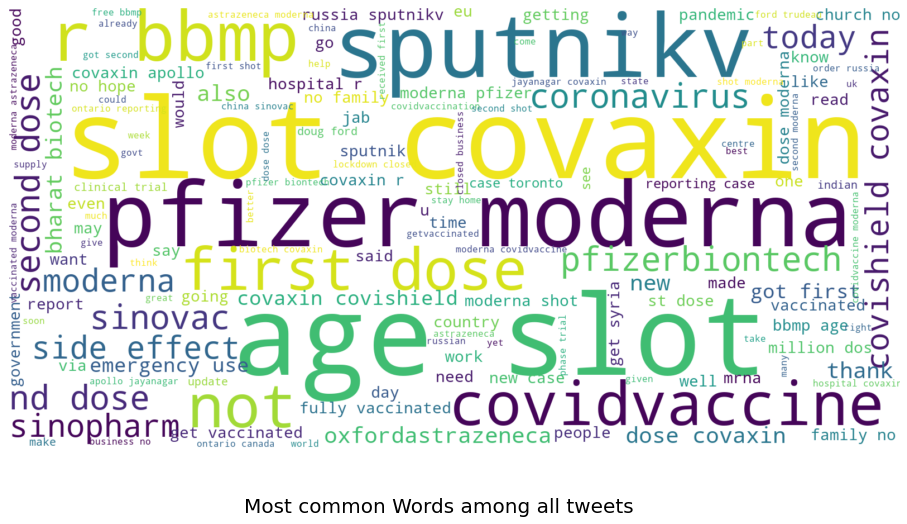

In [189]:
generate_wordcloud(vaccine_tweets["corpus"], "Most common Words among all tweets")

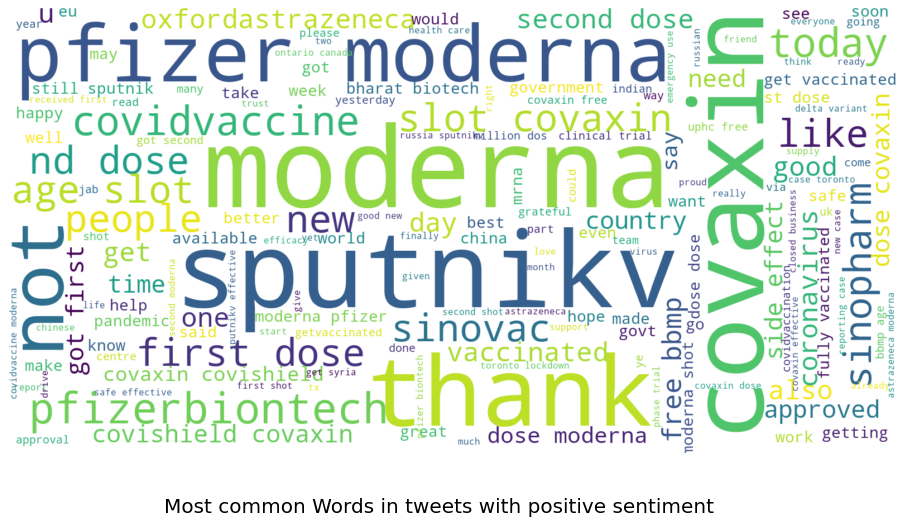

In [45]:
generate_wordcloud(vaccine_tweets["corpus"][vaccine_tweets["sentiment_compound"] >= 0.33], "Most common Words in tweets with positive sentiment")

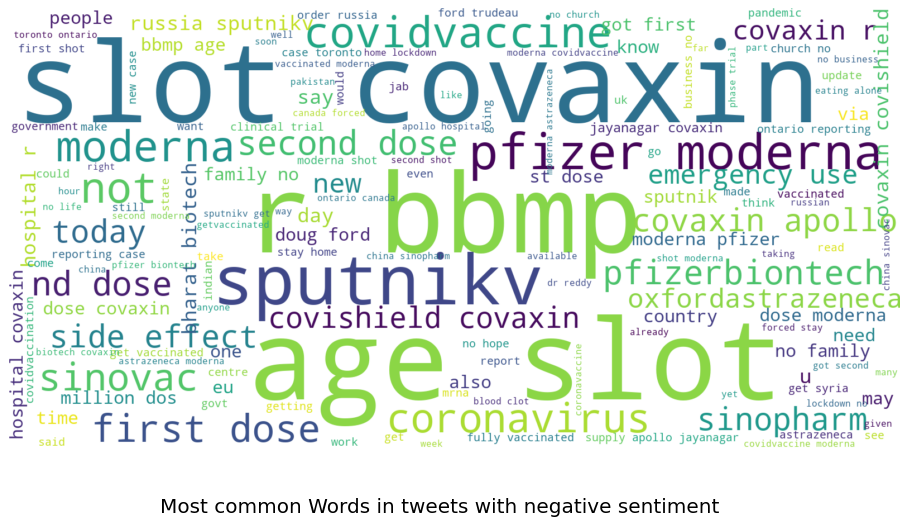

In [46]:
generate_wordcloud(vaccine_tweets["corpus"][vaccine_tweets["sentiment_compound"] <= 0.33], "Most common Words in tweets with negative sentiment")

**For further text analysis, check 06_AM_NLP_Anlaysis**